# GANs and Diffusion Models
---

В этом задании вы обучите генеративно-состязательную и диффузионную модели на датасете [Fashion Mnist](https://github.com/zalandoresearch/fashion-mnist). *Hope you'll enjoy it!*

## Ссылка на работу в Kaggle: https://www.kaggle.com/code/deobject/dl-homework-8
## Там находится точно та же самая работа, но с интерактивными слайдерами, демонстрирующие прогресс обучения генератора по эпохам (при сохранении ноутбука в .ipynb они пропадают)

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset

import torchvision
import matplotlib.pyplot as plt
import numpy as np

from torch.autograd import Variable

In [2]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [3]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

## Задание 1: GAN (5 баллов)

1. Модифицируйте код и реализуйте [Wasserstein GAN](https://arxiv.org/abs/1701.07875) \([From GAN to WGAN](https://lilianweng.github.io/posts/2017-08-20-gan/)\), используя weight clipping (2 балла);

2. Замените  weight clipping на [gradient penalty](https://arxiv.org/pdf/1704.00028v3.pdf) (1 балл);

3. Добавьте к обучению WGAN условие на метку, продемонстрируйте [условную генерацию](https://arxiv.org/pdf/1411.1784.pdf) (2 балла);

4. Напишите отчет о том, что попробовали, какие результаты получили, какую архитектуру использовали, как вам кажется надо обучать GAN, чтобы добиться сходимости? **Каждый пункт обязательно сопроводите визуализациями**.

In [4]:
class Config:
    def __init__(
        self,
        mnist_path: str = None,
        batch_size: int = 16,
        num_workers: int = 4,
        num_epochs: int = 10,
        noise_size: int = 100,
        print_freq: int = 100
    ):
        self.mnist_path = mnist_path
        self.batch_size = batch_size
        self.num_workers = num_workers
        self.num_epochs = num_epochs
        self.noise_size = noise_size
        self.print_freq = print_freq
        
    def __repr__(self):
        return (
            f"path={self.mnist_path} \
            \nbatch_size={self.batch_size} \
            \nnum_workers={self.num_workers} \
            \nnum_epochs={self.num_epochs} \
            \nnoise_size={self.noise_size} \
            \nprint_freq={self.print_freq} \
            "
        )

config = Config()

In [5]:
train_dataset = torchvision.datasets.FashionMNIST("fashion_mnist", train=True, transform=torchvision.transforms.ToTensor(), download=True)
dataloader = DataLoader(
    train_dataset, 
    batch_size=config.batch_size, 
    num_workers=config.num_workers,
    shuffle=True
)

## Визуализация экземпляров датасета

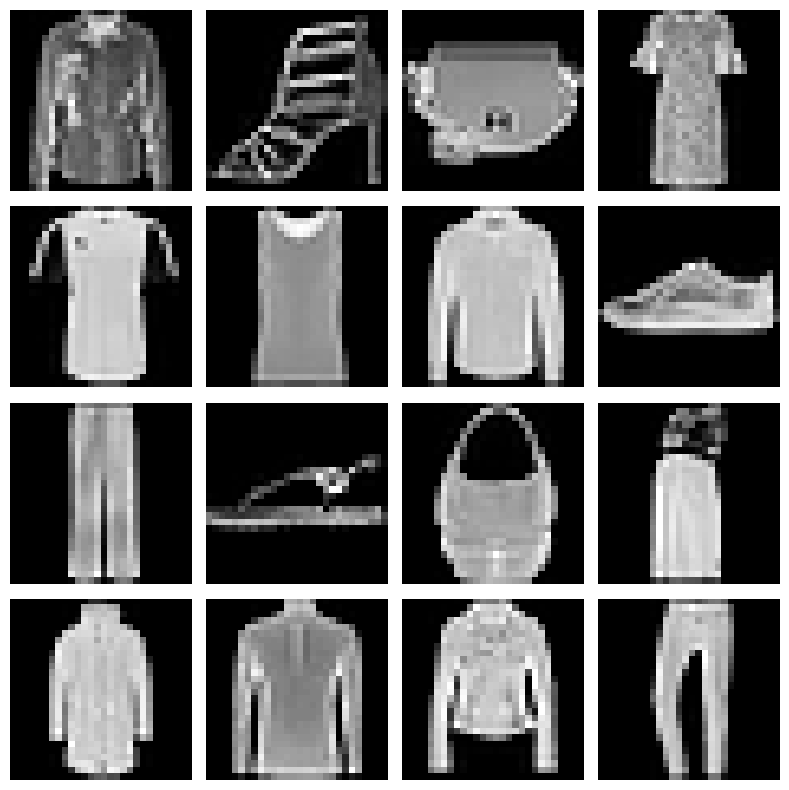

In [6]:
images, _ = next(iter(dataloader))

image_batch = images.squeeze(1)
image_batch = image_batch.cpu().detach().numpy()

fig, axes = plt.subplots(4, 4, figsize=(8, 8))
axes = axes.ravel()

for i in range(16):
    axes[i].imshow(image_batch[i], cmap='gray')
    axes[i].axis('off')

plt.tight_layout()
plt.show()

In [6]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(config.noise_size, 200),
            nn.ReLU(inplace=True),
            nn.Linear(200, 28*28),
            nn.Sigmoid())

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(28*28, 200),
            nn.ReLU(inplace=True),
            nn.Linear(200, 50),
            nn.ReLU(inplace=True),
            nn.Linear(50, 1),
            nn.Sigmoid())
        
    def forward(self, x):
        return self.model(x)

## Обучение на нескольких GPU

In [13]:
G = Generator()
D = Discriminator()

if device == "cuda" and torch.cuda.device_count() > 1:
    G = nn.DataParallel(G)
    D = nn.DataParallel(D)

G.to(device)
D.to(device)

DataParallel(
  (module): Discriminator(
    (model): Sequential(
      (0): Linear(in_features=784, out_features=200, bias=True)
      (1): ReLU(inplace=True)
      (2): Linear(in_features=200, out_features=50, bias=True)
      (3): ReLU(inplace=True)
      (4): Linear(in_features=50, out_features=1, bias=True)
      (5): Sigmoid()
    )
  )
)

In [20]:
optim_G = optim.Adam(params=G.parameters(), lr=0.0001)
optim_D = optim.Adam(params=D.parameters(), lr=0.0001)

criterion = nn.BCELoss()

real_label = 1
fake_label = 0

# Обучение GAN как в оригинальной статье
## References  
- Goodfellow, I. J., Pouget-Abadie, J., Mirza, M., Xu, B., Warde-Farley, D., Ozair, S., ... & Bengio, Y. (2014).  
  **Generative Adversarial Networks.** *arXiv:1406.2661*.  
  [https://arxiv.org/abs/1406.2661](https://arxiv.org/abs/1406.2661)
- Based on **Algorithm 1** 
- **Changes:**  
  - Used `k>1` (instead of `k=1` in the original).  
  - Replaced generator loss with `-log(D(G(z)))` (non-saturating heuristic). 

## Сначала Discriminator обучается k итераций (гиперпараметр), затем Generator

In [10]:
config.k = 2

## Фунцкия для обучения GAN. Возвращает логи потерь для генератора и дискриминатора, а также список батчей изображений после каждой эпохи. Сэмплируются из фиксированного шума

In [11]:
def train(
    G: torch.nn, # Generator
    D: torch.nn, # Discriminator
    optim_G: optim,
    optim_D: optim,
    criterion: torch.nn,
    dataloader: DataLoader,
    config: Config,
    real_label: int = 0.9,
    fake_label: int = 0.1
):
    log_loss_G = [] # G losses
    log_loss_D = [] # D losses
    img_list = []   # List of fake images for future vizualization of generator progress
    # Batch of fixed noize
    fixed_noise = torch.randn(16, config.noise_size).to(device)
    
    for epoch in range(config.num_epochs):
        for i, (images, _) in enumerate(dataloader):
            batch_size = images.size(0)
            
            real_labels = torch.full((batch_size, 1), real_label, dtype=torch.float, device=device)
            fake_labels = torch.full((batch_size, 1), fake_label, dtype=torch.float, device=device)
    
            # -- Training D for k steps -- maximize log(D(x)) + log(1 - D(G(z)))
            for _ in range(config.k):
                z = torch.randn(batch_size, config.noise_size) # Sample minibatch of noise from prior distribution 
                x = images.to(device).view(images.shape[0], -1) # Sample minibatch of examples from data generating distribution
                
                # Real images
                D_real = D(x)
                loss_D_real = criterion(D_real, real_labels)

                # Fake images
                fake_images = G(z).detach()
                D_fake = D(fake_images)
                loss_D_fake = criterion(D_fake, fake_labels)
                
                # Total D loss
                loss_D = loss_D_real + loss_D_fake
                
                # Update D
                optim_D.zero_grad()
                loss_D.backward()
                optim_D.step()
                
            # -- Training G -- maximize log(D(G(z)))
            z = torch.randn(batch_size, config.noise_size) # Sample minibatch of noize from prior distribution
            fake_images = G(z)
            D_fake = D(fake_images)
            
            loss_G = criterion(D_fake, real_labels)
            
            # Update G
            optim_G.zero_grad()
            loss_G.backward()
            optim_G.step()

            log_loss_G.append(loss_G.item())
            log_loss_D.append(loss_D.item())
            
            if i % config.print_freq == 0:
                print(f"Epoch [{epoch+1}/{config.num_epochs}] Batch {i}/{len(dataloader)} "
                      f"Loss_D: {loss_D.item():.4f} Loss_G: {loss_G.item():.4f}")
                
        with torch.no_grad():
            fake = G(fixed_noise).detach().cpu()
            img_list.append(fake)
            
    return log_loss_G, log_loss_D, img_list

## Функция для визуализации изображений

In [30]:
def generate_and_plot_samples(images):    
    fig, axes = plt.subplots(4, 4, figsize=(8, 8))
    images = images.view(-1, 28, 28)
    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i].squeeze(), cmap='gray')
        ax.axis('off')
    plt.show()

## Крутая функция для крутой анимации прогресса генератора по эпохам

In [31]:
def create_animation(img_list: list):
    fig, axes = plt.subplots(4, 4, figsize=(8, 8))
    plt.close(fig)

    imgs = []
    for ax in axes.flat:
        img = ax.imshow(np.zeros((28, 28)), cmap='gray', vmin=0, vmax=1)
        ax.axis('off')
        imgs.append(img)

    def update_frame(idx):
        batch = img_list[idx].reshape(-1, 28, 28)
        batch = (batch - batch.min()) / (batch.max() - batch.min())
        for i, img in enumerate(imgs):
            img.set_array(batch[i])
        fig.suptitle(f'Batch {idx} | Range: {batch.min():.2f}-{batch.max():.2f}', y=1.02)
        return imgs

    ani = FuncAnimation(fig, update_frame, frames=len(img_list), interval=500, blit=True)
    return HTML(ani.to_jshtml())

## Функция для генерации и визуализации изображений с обученным генератором

In [40]:
def visualize_generated_images(generator, n_samples=25, latent_dim=100, figsize=(10,10)):
    z = torch.randn(n_samples, latent_dim)
    
    with torch.no_grad():
        generated = generator(z).cpu().numpy()
    
    plt.figure(figsize=figsize)
    grid_size = int(np.sqrt(n_samples))
    for i in range(n_samples):
        plt.subplot(grid_size, grid_size, i+1)
        img = generated[i].reshape(28, 28)
        plt.imshow(img, cmap='gray')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

## Функция для визуализации потерь

In [32]:
def visualize_losses(G_losses, D_losses, title: str = "Generator and Discriminator Loss During Training"):
    plt.figure(figsize=(10, 5))
    plt.title(title)
    plt.plot(G_losses, label="G")
    plt.plot(D_losses, label="D")
    plt.xlabel("iterations")
    plt.legend()
    plt.show()

In [21]:
config

path=None             
batch_size=16             
num_workers=4             
num_epochs=10             
noise_size=100             
print_freq=100             

In [11]:
result = train(
    G=G,
    D=D,
    optim_G=optim_G,
    optim_D=optim_D,
    criterion=criterion,
    dataloader=dataloader,
    config=config,
    real_label = 1,
    fake_label = 0
)

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/linear.py:125: UserWarning: Attempting to run cuBLAS, but there was no current CUDA context! Attempting to set the primary context... (Triggered internally at ../aten/src/ATen/cuda/CublasHandlePool.cpp:135.)
  return F.linear(input, self.weight, self.bias)


Epoch [1/10] Batch 0/3750 Loss_D: 1.4003 Loss_G: 0.7344
Epoch [1/10] Batch 100/3750 Loss_D: 0.0784 Loss_G: 3.5944
Epoch [1/10] Batch 200/3750 Loss_D: 0.0942 Loss_G: 4.1470
Epoch [1/10] Batch 300/3750 Loss_D: 0.1625 Loss_G: 3.2855
Epoch [1/10] Batch 400/3750 Loss_D: 0.3938 Loss_G: 3.0213
Epoch [1/10] Batch 500/3750 Loss_D: 0.0216 Loss_G: 4.5091
Epoch [1/10] Batch 600/3750 Loss_D: 0.1937 Loss_G: 4.1544
Epoch [1/10] Batch 700/3750 Loss_D: 0.0771 Loss_G: 4.4382
Epoch [1/10] Batch 800/3750 Loss_D: 0.6540 Loss_G: 3.2209
Epoch [1/10] Batch 900/3750 Loss_D: 0.1859 Loss_G: 3.5223
Epoch [1/10] Batch 1000/3750 Loss_D: 0.0930 Loss_G: 2.5403
Epoch [1/10] Batch 1100/3750 Loss_D: 0.0479 Loss_G: 3.9447
Epoch [1/10] Batch 1200/3750 Loss_D: 0.1378 Loss_G: 4.0244
Epoch [1/10] Batch 1300/3750 Loss_D: 0.1161 Loss_G: 2.8002
Epoch [1/10] Batch 1400/3750 Loss_D: 0.1313 Loss_G: 2.9235
Epoch [1/10] Batch 1500/3750 Loss_D: 0.0690 Loss_G: 3.3943
Epoch [1/10] Batch 1600/3750 Loss_D: 0.0993 Loss_G: 3.3182
Epoch [1/

In [12]:
G_losses_gan, D_losses_gan, images_gan = result

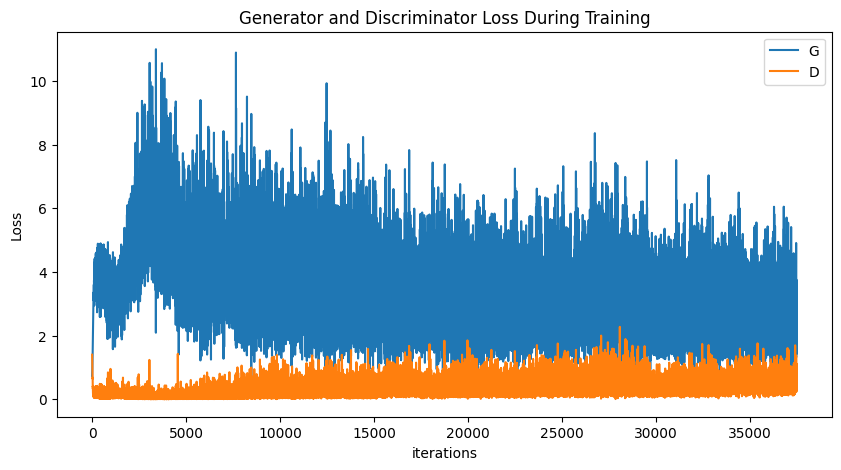

In [13]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses_gan, label="G")
plt.plot(D_losses_gan, label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

## Результат работы генератора после обучения:

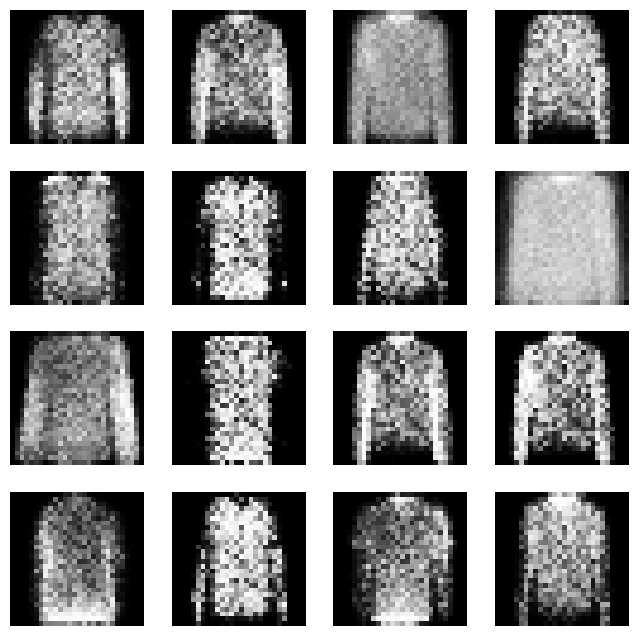

In [18]:
generate_and_plot_samples(images_gan[-1])

# Прогресс генератора по эпохам:

In [17]:
create_animation(img_list=images_gan)

## Вывод: получились достаточно шумные изображения. Плюс, все изображения очень похожи друг на друга и не видно разнообразия датасета

## Возможно, 10 эпох для ванильного GAN мало. Авторы оригинальной статьи использовали batch_size = 100 (https://github.com/goodfeli/adversarial/blob/master/cifar10_fully_connected.yaml). Обучим на большем кол-ве эпох и с большим размером батча:

In [21]:
config.num_epochs = 100
config.batch_size = 128
config.print_freq = 200
config.k = 2

In [22]:
config

path=None             
batch_size=128             
num_workers=4             
num_epochs=100             
noise_size=100             
print_freq=200             

In [23]:
result_2 = train(
    G=G,
    D=D,
    optim_G=optim_G,
    optim_D=optim_D,
    criterion=criterion,
    dataloader=dataloader,
    config=config,
    real_label = 1,
    fake_label = 0
)

Epoch [1/100] Batch 0/3750 Loss_D: 1.3613 Loss_G: 0.6696
Epoch [1/100] Batch 200/3750 Loss_D: 0.1118 Loss_G: 3.9069
Epoch [1/100] Batch 400/3750 Loss_D: 0.2422 Loss_G: 3.5590
Epoch [1/100] Batch 600/3750 Loss_D: 0.1277 Loss_G: 3.9727
Epoch [1/100] Batch 800/3750 Loss_D: 0.0243 Loss_G: 4.0404
Epoch [1/100] Batch 1000/3750 Loss_D: 0.1348 Loss_G: 2.3808
Epoch [1/100] Batch 1200/3750 Loss_D: 0.3099 Loss_G: 2.9095
Epoch [1/100] Batch 1400/3750 Loss_D: 0.1157 Loss_G: 3.1098
Epoch [1/100] Batch 1600/3750 Loss_D: 0.1728 Loss_G: 2.7723
Epoch [1/100] Batch 1800/3750 Loss_D: 0.1527 Loss_G: 4.5173
Epoch [1/100] Batch 2000/3750 Loss_D: 0.0811 Loss_G: 3.4512
Epoch [1/100] Batch 2200/3750 Loss_D: 0.1835 Loss_G: 3.7377
Epoch [1/100] Batch 2400/3750 Loss_D: 0.0080 Loss_G: 5.8700
Epoch [1/100] Batch 2600/3750 Loss_D: 0.0453 Loss_G: 4.3866
Epoch [1/100] Batch 2800/3750 Loss_D: 0.0447 Loss_G: 3.3876
Epoch [1/100] Batch 3000/3750 Loss_D: 0.1497 Loss_G: 6.2882
Epoch [1/100] Batch 3200/3750 Loss_D: 0.0836 Lo

In [24]:
G_losses_gan_2, D_losses_gan_2, images_gan_2 = result_2

## Посмотрим на результат:

In [26]:
create_animation(images_gan_2)

## Сгенерируем 100 изображений:

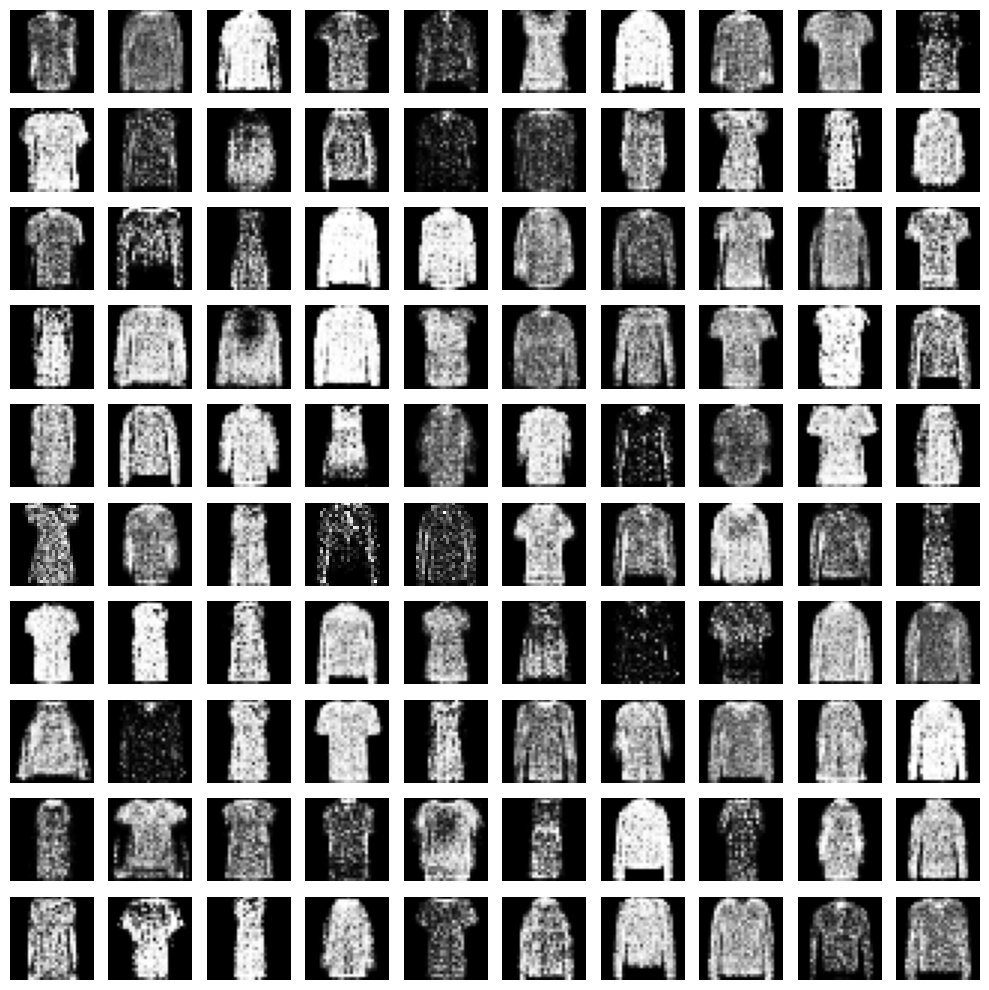

In [39]:
visualize_generated_images(generator=G, n_samples=100)

## По сгенерированным выше изображениям хорошо видно, что они все очень похожи друг на друга, разнообразия по классам почти что нет. Это известная проблема ванильного GAN: mode collapse. Модель выучила один паттерн, которым ей удалось "обмануть" дискриминатор

## Решить эту проблему может WGAN. Обучим его, использую weight clipping и gradient penalty

# WGAN (weight clipping)

## References  
- Lilian Weng (2019).  
  **From GAN to WGAN.** *arXiv:1904.08994*.  
  [https://arxiv.org/pdf/1904.08994](https://arxiv.org/pdf/1904.08994)
- Based on **Algorithm 1** 

In [14]:
config.batch_size = 64
config.num_epochs = 100

config

path=None             
batch_size=64             
num_workers=4             
num_epochs=100             
noise_size=100             
print_freq=100             

In [20]:
n_critic = 5
clip_value = 0.01

generator = nn.DataParallel(Generator()).to(device)
critic = nn.DataParallel(Discriminator()).to(device)

optim_G = optim.RMSprop(generator.parameters(), lr=0.00005)
optim_C = optim.RMSprop(critic.parameters(), lr=0.00005)

## Функция для обучения WGAN с weight clipping:

In [21]:
def train_wgan_with_clipping(
    generator: torch.nn,
    critic: torch.nn,
    optim_G: optim,
    optim_C: optim,
    dataloader: DataLoader,
    config: Config
):
    losses_C = []
    losses_G = []
    img_list = []
    
    fixed_noise = torch.randn(16, config.noise_size).to(device)
    
    for epoch in range(config.num_epochs):
        for i, (images, _) in enumerate(dataloader):   
            batch_size = images.size(0)
            
            # -- Training Critic --
            for _ in range(n_critic): 
                z = torch.randn(batch_size, config.noise_size) # Sample minibatch of noise from prior distribution 
                x = images.to(device).view(images.shape[0], -1) # Sample minibatch of real data
                
                fake_data = generator(z)

                loss_C = torch.mean(critic(fake_data)) - torch.mean(critic(x))
                
                # Update Critic
                optim_C.zero_grad()
                loss_C.backward()
                optim_C.step()
                
                for p in critic.parameters():
                    p.data.clamp_(-clip_value, clip_value)
                    
            # -- Training Generator --
            z = torch.randn(batch_size, config.noise_size) # Sample minibatch of noise from prior distribution
            
            fake_data = generator(z)
            loss_G = -torch.mean(critic(fake_data))
            
            # Update Generator
            optim_G.zero_grad()
            loss_G.backward()
            optim_G.step()
            
            losses_G.append(loss_G.item())
            losses_C.append(loss_C.item())
            
            if i % config.print_freq == 0:
                print(f"Epoch [{epoch+1}/{config.num_epochs}] Batch {i}/{len(dataloader)} "
                      f"Loss_C: {loss_C.item():.4f} Loss_G: {loss_G.item():.4f}")

        with torch.no_grad():
            fake = generator(fixed_noise).detach().cpu()
            img_list.append(fake)

    return losses_G, losses_C, img_list

In [22]:
wgan_clipping_result = train_wgan_with_clipping(
    generator=generator,
    critic=critic,
    optim_G=optim_G,
    optim_C=optim_C,
    dataloader=DataLoader(
        train_dataset, 
        batch_size=config.batch_size, 
        num_workers=config.num_workers,
        shuffle=True
    ),
    config=config
)

Epoch [1/100] Batch 0/938 Loss_C: -0.0003 Loss_G: -0.4974
Epoch [1/100] Batch 100/938 Loss_C: -0.0915 Loss_G: -0.4629
Epoch [1/100] Batch 200/938 Loss_C: -0.0627 Loss_G: -0.4735
Epoch [1/100] Batch 300/938 Loss_C: -0.0510 Loss_G: -0.4669
Epoch [1/100] Batch 400/938 Loss_C: -0.0614 Loss_G: -0.4640
Epoch [1/100] Batch 500/938 Loss_C: -0.0605 Loss_G: -0.4663
Epoch [1/100] Batch 600/938 Loss_C: -0.0560 Loss_G: -0.4660
Epoch [1/100] Batch 700/938 Loss_C: -0.0519 Loss_G: -0.4690
Epoch [1/100] Batch 800/938 Loss_C: -0.0454 Loss_G: -0.4709
Epoch [1/100] Batch 900/938 Loss_C: -0.0359 Loss_G: -0.4773
Epoch [2/100] Batch 0/938 Loss_C: -0.0377 Loss_G: -0.4824
Epoch [2/100] Batch 100/938 Loss_C: -0.0400 Loss_G: -0.4883
Epoch [2/100] Batch 800/938 Loss_C: -0.0186 Loss_G: -0.5109
Epoch [2/100] Batch 900/938 Loss_C: -0.0152 Loss_G: -0.4967
Epoch [3/100] Batch 0/938 Loss_C: -0.0124 Loss_G: -0.4969
Epoch [3/100] Batch 100/938 Loss_C: -0.0113 Loss_G: -0.4947
Epoch [3/100] Batch 200/938 Loss_C: -0.0094 Lo

In [27]:
G_losses_gan_2, C_losses_gan_2, images_wgan_with_clipping = wgan_clipping_result

## Посмотрим, что получилось:

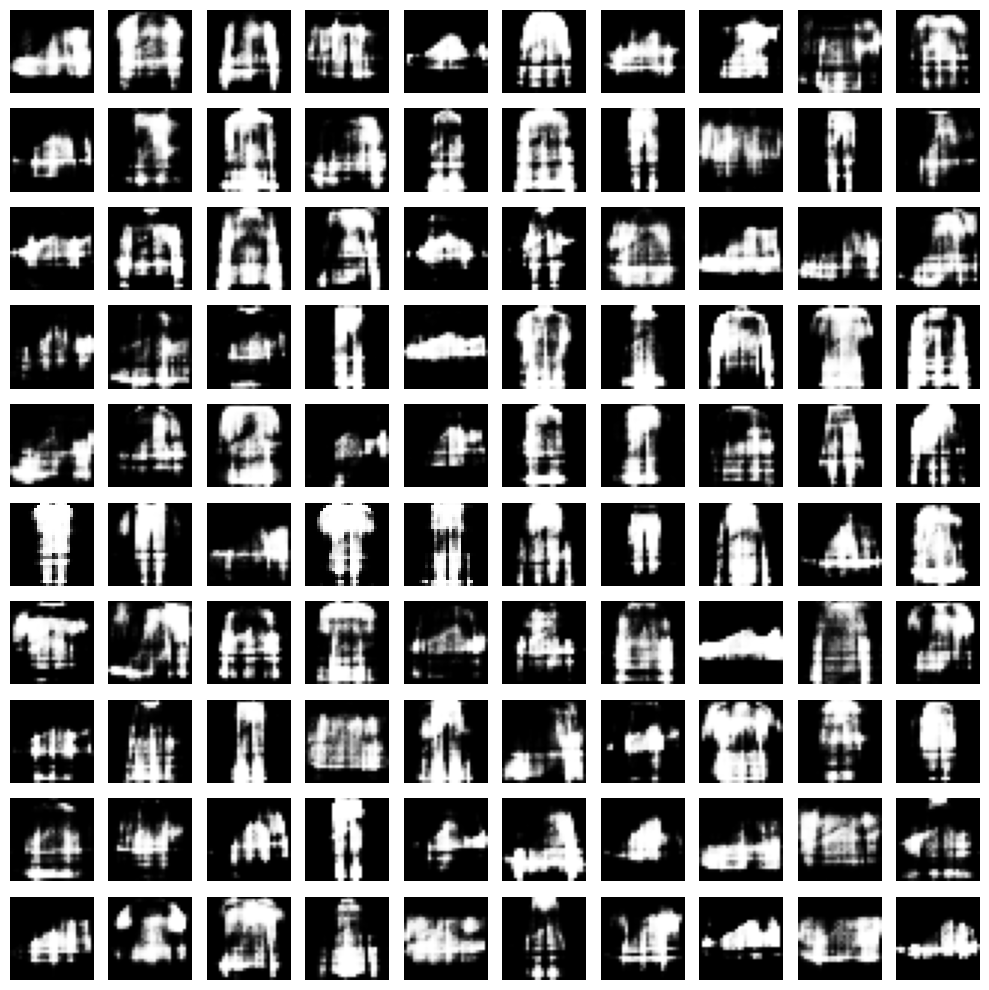

In [31]:
visualize_generated_images(generator, n_samples=100)

In [34]:
create_animation(images_wgan_with_clipping)

## Ужас, получился мой гардероб (7 ряд 10 колонка моя любимая футблока)
## Однако, можно увидеть кое-что важное: несмотря на ужасное качество, мы получили какое-то разнообразие в сгенерированных изображениях. Можно заметить как минимум обувь и брюки. В ванильном GAN изображения хоть и не были такими страшными, они все представляли из себя что-то похожее на футболку.
## Почему изображения получились "сломанными"? Скорее всего, из-за грубого подхода с weight clipping, который заставляет веса быть в одном небольшом диапазоне, что может привести с исчезающим градиентам и перенасыщению.

## WGAN представляет более элегантный способ добиться соблюдения "Lipschitz constraint":

# WGAN-GP

## References  
- Ishaan Gulrajani, Faruk Ahmed, Martin Arjovsky, Vincent Dumoulin, Aaron Courville (2017).  
  **Improved Training of Wasserstein GANs** *arXiv:1704.00028*.  
  [https://arxiv.org/pdf/1704.00028v3](https://arxiv.org/pdf/1704.00028v3)
- Based on **Algorithm 1** 

In [20]:
Tensor = torch.cuda.FloatTensor if device == "cuda" else torch.FloatTensor

In [21]:
config.batch_size = 64
config.num_epochs = 100
config

path=None             
batch_size=64             
num_workers=4             
num_epochs=100             
noise_size=100             
print_freq=100             

In [26]:
n_critic = 5
lambda_gp = 10
alpha = 0.0001
beta_1 = 0
beta_2 = 0.9

# Crashes on 2 GPUs :(
# generator = nn.DataParallel(Generator()).to(device)
# critic = nn.DataParallel(Discriminator()).to(device)
generator = Generator().to(device)
critic = Discriminator().to(device)

optim_G = optim.Adam(generator.parameters(), lr=alpha, betas=(beta_1, beta_2))
optim_C = optim.Adam(critic.parameters(), lr=alpha, betas=(beta_1, beta_2))

In [27]:
def train_wgan_with_gp(
    generator=generator,
    critic=critic,
    optim_G=optim_G,
    optim_C=optim_C,
    dataloader=DataLoader,
    config=config
):
    losses_G = []
    losses_C = []
    img_list = []
    
    fixed_noise = torch.randn(16, config.noise_size).to(device)
    
    for epoch in range(config.num_epochs):
        for i, (images, _) in enumerate(dataloader):
            batch_size = images.size(0)
            
            # -- Training Critic --
            for _ in range(n_critic):
                optim_C.zero_grad()
                x = Variable(images.type(Tensor)).view(images.shape[0], -1) # Sample real data x ~ P_r     
                z = Variable(Tensor(np.random.normal(0, 1, (batch_size, config.noise_size)))) # Sample latent variable z ~ p(z)
                x_fake = generator(z) # x_fake <- G(z)
            
                real_scores = critic(x)
                fake_scores = critic(x_fake)
            
                gp = compute_gradient_penalty(critic, x.data, x_fake.data)
        
                # Update Critic
                loss_C = -torch.mean(real_scores) + torch.mean(fake_scores) + lambda_gp * gp
                loss_C.backward()
                optim_C.step()

            # -- Training Generator --
            optim_G.zero_grad()
        
            z = Variable(Tensor(np.random.normal(0, 1, (batch_size, config.noise_size))))
            x_fake = generator(z)
            fake_scores = critic(x_fake)
        
            # Update Generator
            loss_G = -torch.mean(fake_scores)
            loss_G.backward()
            optim_G.step()
        
            losses_G.append(loss_G.item())
            losses_C.append(loss_C.item())

            if i % config.print_freq == 0:
                print(f"Epoch [{epoch+1}/{config.num_epochs}] Batch {i}/{len(dataloader)} "
                    f"Loss_C: {loss_C.item():.4f} Loss_G: {loss_G.item():.4f}")
                
        with torch.no_grad():
            fake = generator(fixed_noise).detach().cpu()
            img_list.append(fake)

    return losses_G, losses_C, img_list

## Функция для вычисления gradient penalty:

In [28]:
def compute_gradient_penalty(D, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    epsilon = torch.rand(real_samples.size(0), 1, 1, 1, device=device) # Sample random number epsilon ~ U[0, 1]
    
    # Get random interpolation between real and fake samples
    interpolated = (epsilon * real_samples + ((1 - epsilon) * fake_samples)).requires_grad_(True)
    d_interpolated = D(interpolated).requires_grad_(True)
    
    # Get gradient w.r.t. interpolates
    gradients = torch.autograd.grad(
        outputs=d_interpolated,
        inputs=interpolated,
        grad_outputs=torch.ones_like(d_interpolated),
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    
    return gradient_penalty

In [29]:
losses_G_wgan_gp, losses_C_wgan_gp, images_wgan_gp = train_wgan_with_gp(
    generator,
    critic,
    optim_G,
    optim_C,
    DataLoader(
        train_dataset, 
        batch_size=config.batch_size, 
        num_workers=config.num_workers,
        shuffle=True
    ),
    config
)

Epoch [1/100] Batch 0/938 Loss_C: 5.6587 Loss_G: -0.4581
Epoch [1/100] Batch 100/938 Loss_C: -0.4246 Loss_G: -0.2439
Epoch [1/100] Batch 200/938 Loss_C: -0.4563 Loss_G: -0.2018
Epoch [1/100] Batch 300/938 Loss_C: -0.4796 Loss_G: -0.2084
Epoch [1/100] Batch 400/938 Loss_C: -0.4853 Loss_G: -0.2100
Epoch [1/100] Batch 500/938 Loss_C: -0.4680 Loss_G: -0.2341
Epoch [1/100] Batch 600/938 Loss_C: -0.4792 Loss_G: -0.2284
Epoch [1/100] Batch 700/938 Loss_C: -0.4343 Loss_G: -0.2696
Epoch [1/100] Batch 800/938 Loss_C: -0.4064 Loss_G: -0.2725
Epoch [1/100] Batch 900/938 Loss_C: -0.4209 Loss_G: -0.2901
Epoch [2/100] Batch 0/938 Loss_C: -0.4127 Loss_G: -0.2663
Epoch [2/100] Batch 100/938 Loss_C: -0.4764 Loss_G: -0.2260
Epoch [2/100] Batch 200/938 Loss_C: -0.4578 Loss_G: -0.2303
Epoch [2/100] Batch 300/938 Loss_C: -0.3998 Loss_G: -0.1712
Epoch [2/100] Batch 400/938 Loss_C: -0.3984 Loss_G: -0.2723
Epoch [2/100] Batch 500/938 Loss_C: -0.3168 Loss_G: -0.3097
Epoch [2/100] Batch 600/938 Loss_C: -0.3078 L

## Результат:

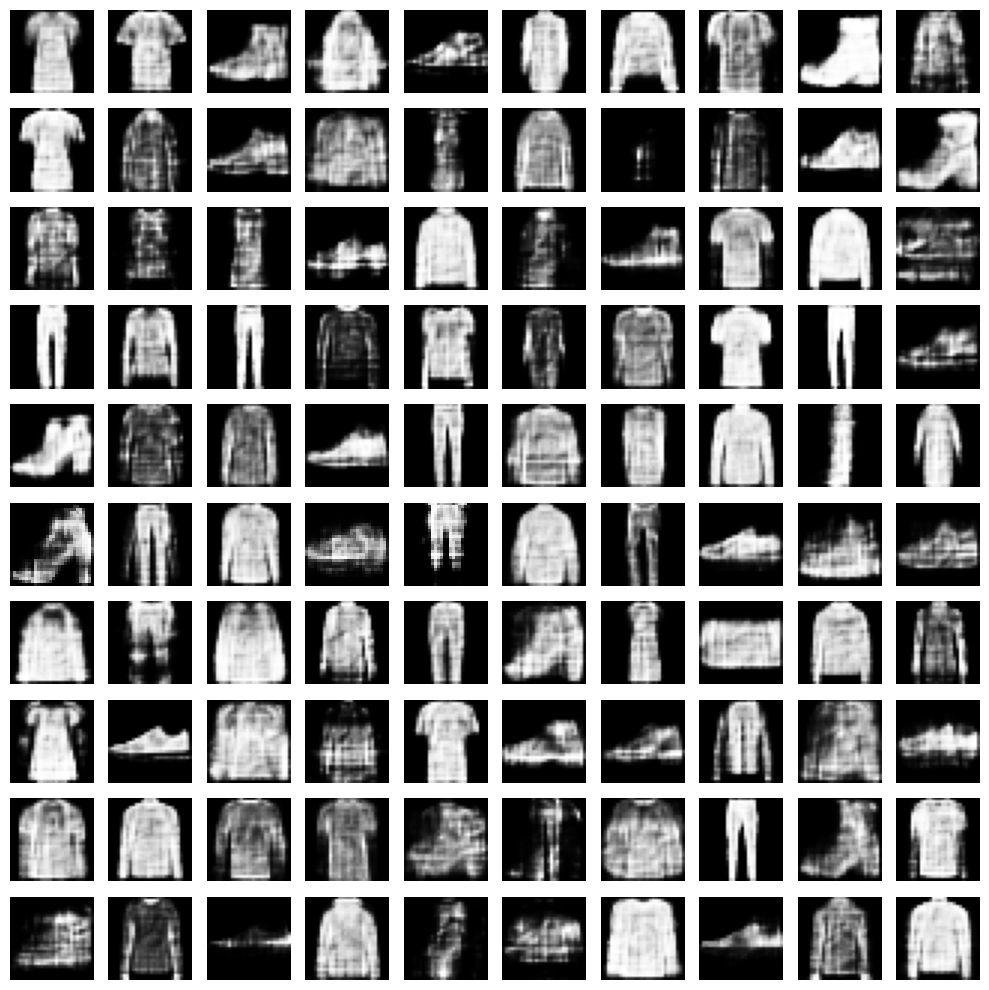

In [41]:
visualize_generated_images(generator.to("cpu"), n_samples=100)

## Получились отличные изображения, а также отчетливо видно различные классы. Можно даже заметить, что модель научилась генерировать "подклассы" (Sneaker и Ankle Boot, например)
## Gradient Penalty более "мягко" обеспечивает соблюдение "Lipschitz constraint", не ограничивая таким образом веса Дискриминатора

In [42]:
create_animation(images_wgan_gp)

## cWGAN-CP

## Чтобы обучить conditional GAN, необходимо модифицировать Генератор и Дискриминатор. Оба должны дополнительно принимать эмбеддинг лейбла. В нашем случае классов всего 10, поэтому добавим в модели слой эмбеддинга размером 10. Этот слой эмбеддинга дифференцируемый, поэтому во время обучения модель научится видеть связь между эмбеддингом и классом.
## Также, была сделана чуть более сложная архитектура

In [97]:
class ConditionalGenerator(nn.Module):
    def __init__(self, latent_dim=100, num_classes=10, output_dim=784):
        super().__init__()
        self.label_embed = nn.Embedding(num_classes, num_classes)
        self.model = nn.Sequential(
            nn.Linear(latent_dim + num_classes, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, output_dim),
            nn.Tanh()
        )
    
    def forward(self, z, labels):
        c = self.label_embed(labels)
        x = torch.cat([z, c], dim=1)
        return self.model(x)

In [98]:
class ConditionalDiscriminator(nn.Module):
    def __init__(self, input_dim=784, num_classes=10):
        super().__init__()
        self.label_embed = nn.Embedding(num_classes, num_classes)
        self.model = nn.Sequential(
            nn.Linear(input_dim + num_classes, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 1)
        )
    
    def forward(self, x, labels):
        c = self.label_embed(labels)
        x = torch.cat([x, c], dim=1)
        return self.model(x)

In [99]:
config

path=None             
batch_size=64             
num_workers=4             
num_epochs=100             
noise_size=100             
print_freq=100             

In [105]:
n_critic = 5
lambda_gp = 10
alpha = 0.0001
beta_1 = 0
beta_2 = 0.9

generator = ConditionalGenerator().to(device)
critic = ConditionalDiscriminator().to(device)

optim_G = optim.Adam(generator.parameters(), lr=alpha, betas=(beta_1, beta_2))
optim_C = optim.Adam(critic.parameters(), lr=alpha, betas=(beta_1, beta_2))

## Цикл обучения как и для WGAN-GP, но слегка модифицированный: теперь Дискриминатор и Генератор принимают на вход помимо вектора (вектор из латентного пространства и изображение соответсвтенно) лейблы

In [106]:
def train_cwgan_with_gp(
    generator=generator,
    critic=critic,
    optim_G=optim_G,
    optim_C=optim_C,
    dataloader=DataLoader,
    config=config
):
    losses_G = []
    losses_C = []
    
    fixed_noise = torch.randn(16, config.noise_size).to(device)
    
    for epoch in range(config.num_epochs):
        for i, (images, labels) in enumerate(dataloader):
            batch_size = images.size(0)
            
            # -- Training Critic --
            for _ in range(n_critic):
                optim_C.zero_grad()
                x = images.to(device).view(images.shape[0], -1) # Sample real data x ~ P_r
                y = labels.to(device) # labels
                z = torch.randn(batch_size, config.noise_size).to(device) # Sample latent variable z ~ p(z)
                x_fake = generator(z, y) # x_fake <- G(z)
            
                real_scores = critic(x, y)
                fake_scores = critic(x_fake, y)
            
                gp = compute_gradient_penalty_with_labels(critic, x, x_fake, y)
        
                # Update Critic
                loss_C = -torch.mean(real_scores) + torch.mean(fake_scores) + lambda_gp * gp
                loss_C.backward()
                optim_C.step()

            # -- Training Generator --
            optim_G.zero_grad()
        
            z = torch.randn(batch_size, config.noise_size).to(device)
            y = labels.to(device)
            x_fake = generator(z, y)
            fake_scores = critic(x_fake, y)
        
            # Update Generator
            loss_G = -torch.mean(fake_scores)
            loss_G.backward()
            optim_G.step()
        
            losses_G.append(loss_G.item())
            losses_C.append(loss_C.item())

            if i % config.print_freq == 0:
                print(f"Epoch [{epoch+1}/{config.num_epochs}] Batch {i}/{len(dataloader)} "
                    f"Loss_C: {loss_C.item():.4f} Loss_G: {loss_G.item():.4f}")

    return losses_G, losses_C

In [107]:
def compute_gradient_penalty_with_labels(D, real_samples, fake_samples, labels):
    """Calculates the gradient penalty loss for WGAN GP"""
    epsilon = torch.rand(real_samples.size(0), 1, device=device) # Sample random number epsilon ~ U[0, 1]
    
    # Get random interpolation between real and fake samples
    interpolated = (epsilon * real_samples + ((1 - epsilon) * fake_samples)).requires_grad_(True)
    d_interpolated = D(interpolated, labels).requires_grad_(True)
    
    # Get gradient w.r.t. interpolates
    gradients = torch.autograd.grad(
        outputs=d_interpolated,
        inputs=interpolated,
        grad_outputs=torch.ones_like(d_interpolated),
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    
    return gradient_penalty

In [108]:
losses_G_cwgan_gp, losses_C_cwgan_gp = train_cwgan_with_gp(
    generator,
    critic,
    optim_G,
    optim_C,
    DataLoader(
        train_dataset, 
        batch_size=config.batch_size, 
        num_workers=config.num_workers,
        shuffle=True
    ),
    config
)

Epoch [1/100] Batch 0/938 Loss_C: 7.0654 Loss_G: 0.0414
Epoch [1/100] Batch 100/938 Loss_C: -4.1664 Loss_G: 0.0743
Epoch [1/100] Batch 200/938 Loss_C: -3.6699 Loss_G: -0.6983
Epoch [1/100] Batch 300/938 Loss_C: -3.6081 Loss_G: -2.3478
Epoch [1/100] Batch 400/938 Loss_C: -3.6090 Loss_G: -3.7537
Epoch [1/100] Batch 500/938 Loss_C: -3.3863 Loss_G: -2.9303
Epoch [1/100] Batch 600/938 Loss_C: -3.9117 Loss_G: -4.5888
Epoch [1/100] Batch 700/938 Loss_C: -4.1134 Loss_G: -7.2557
Epoch [1/100] Batch 800/938 Loss_C: -3.9386 Loss_G: -6.7385
Epoch [1/100] Batch 900/938 Loss_C: -3.7671 Loss_G: -8.3419
Epoch [2/100] Batch 0/938 Loss_C: -3.9608 Loss_G: -6.0180
Epoch [2/100] Batch 100/938 Loss_C: -3.7415 Loss_G: -7.2652
Epoch [2/100] Batch 200/938 Loss_C: -3.1217 Loss_G: -9.1488
Epoch [2/100] Batch 300/938 Loss_C: -2.9751 Loss_G: -8.9864
Epoch [2/100] Batch 400/938 Loss_C: -2.8769 Loss_G: -7.8367
Epoch [2/100] Batch 500/938 Loss_C: -3.4143 Loss_G: -6.6890
Epoch [2/100] Batch 600/938 Loss_C: -2.7380 Los

## Функция, генерирующая изображения с условием:

In [171]:
def generate_class_samples(generator, class_label, n, latent_dim=100):
    generator.eval()
    
    z = torch.randn(n, latent_dim, device=device)
    y = torch.full((n,), class_label, device=device)
    
    # Generate samples
    with torch.no_grad():
        generated_vectors = generator(z, y)
    
    generated_images = generated_vectors.view(n, 28, 28).cpu().numpy()
    
    rows = math.ceil(math.sqrt(n))
    cols = math.ceil(n / rows)
    
    fig, axes = plt.subplots(rows, cols, figsize=(10, 10))
    fig.suptitle(f'Generated {label_to_name[class_label]} Samples', fontsize=16)
    
    for i, ax in enumerate(axes.flat):
        if i < n:
            ax.imshow(generated_images[i], cmap='gray')
            ax.axis('off')
        else:
            ax.axis('off')
    
    plt.tight_layout()
    plt.show()

In [161]:
label_to_name = {
    0: "T-shirt/top",
    1: "Trouser",
    2: "Pullover",
    3: "Dress",
    4: "Coat",
    5: "Sandal",
    6: "Shirt",
    7: "Sneaker",
    8: "Bag",
    9: "Ankle boot"
}

## Посмотрим что получилось. Передадим функции выше обученный генератор и разные лейблы

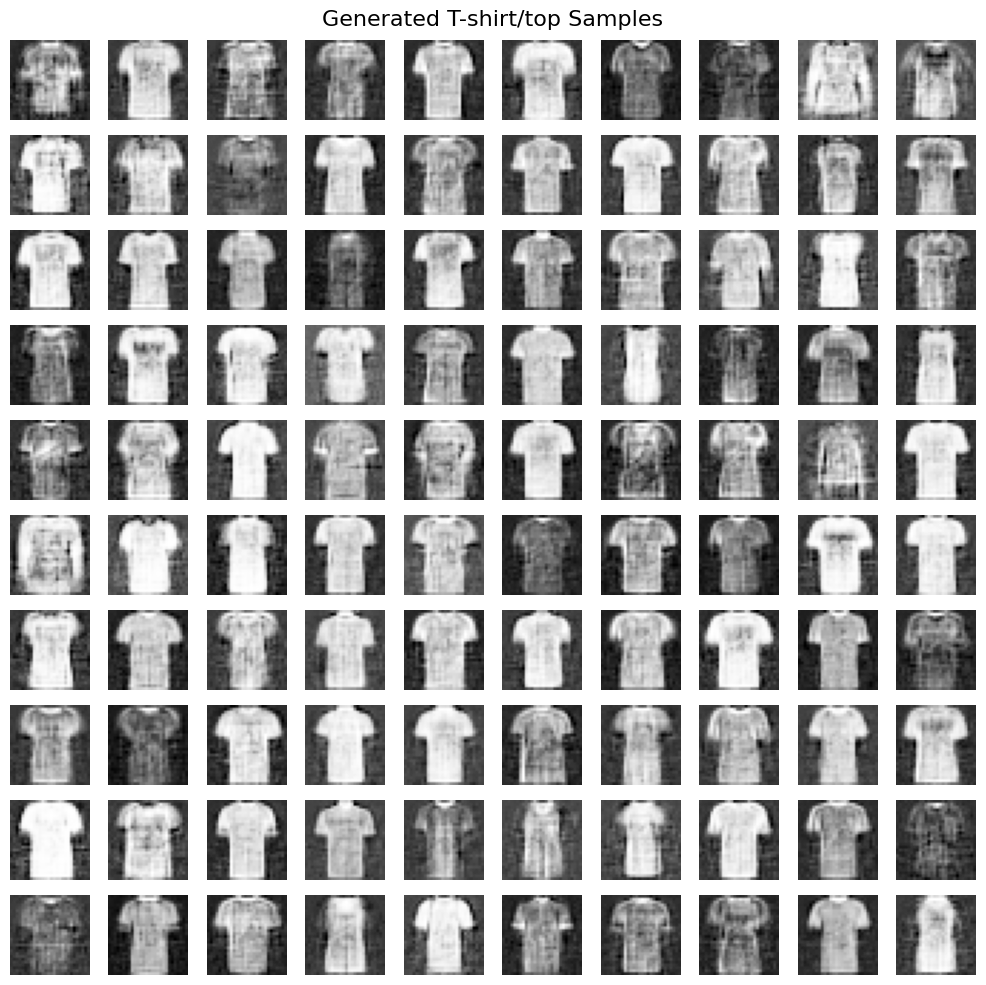

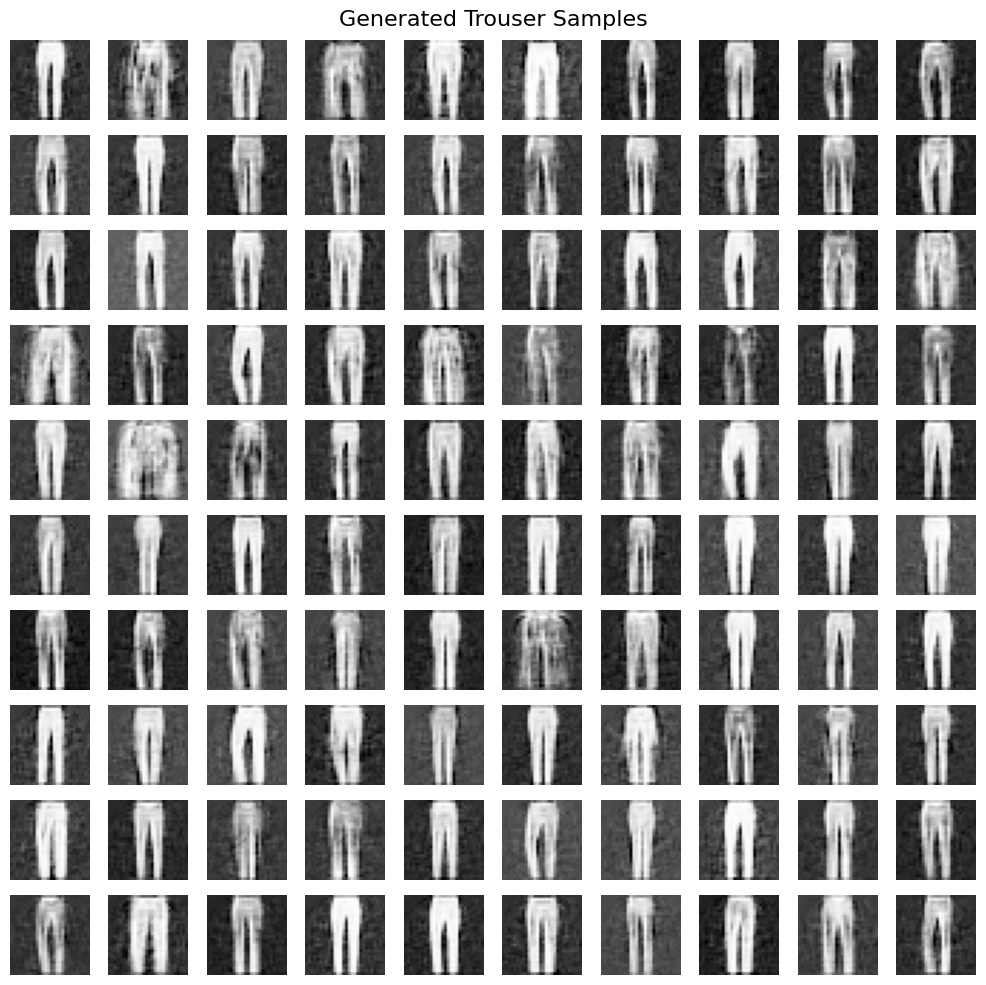

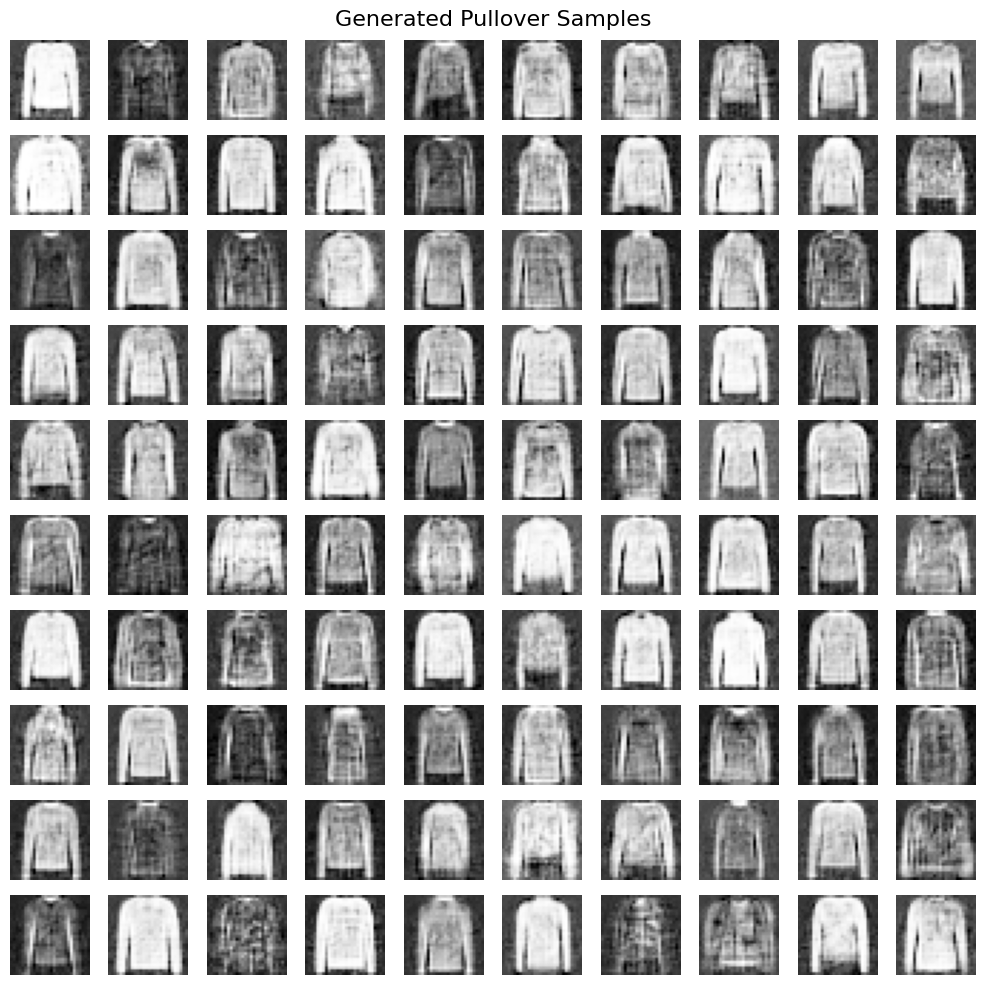

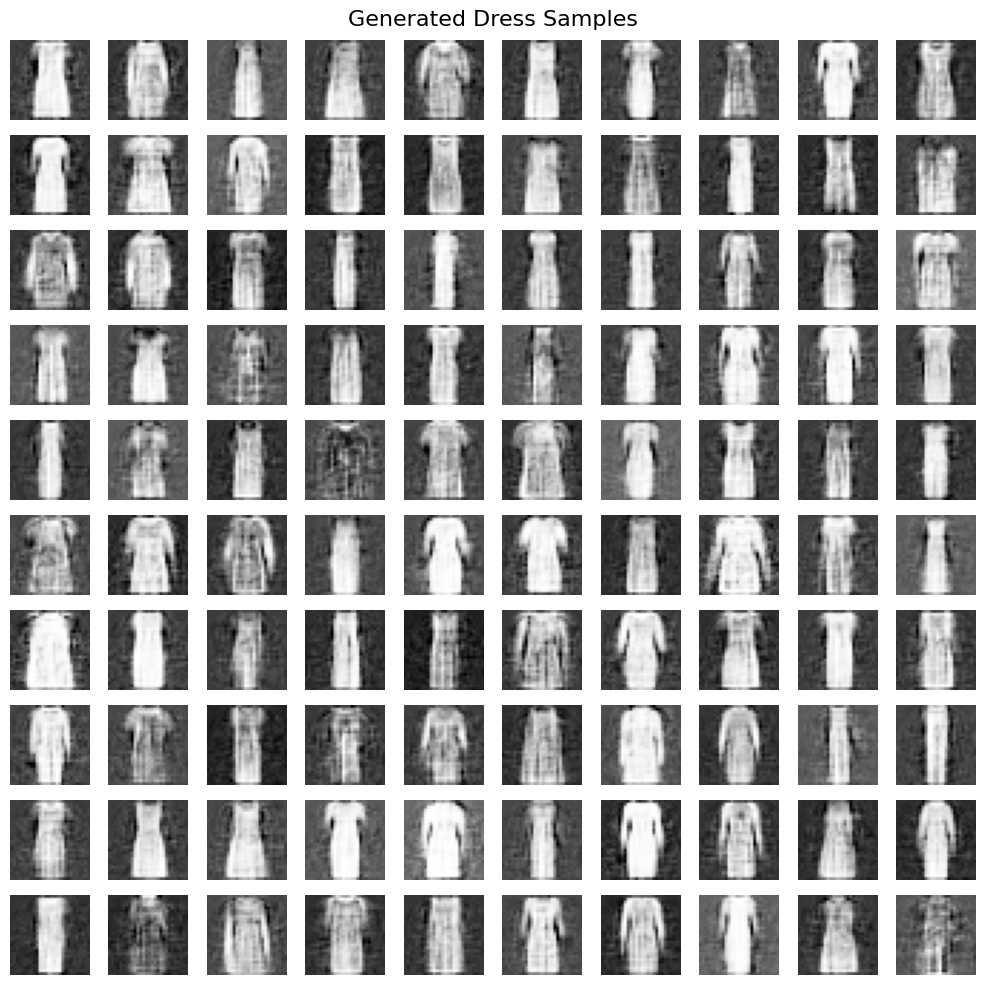

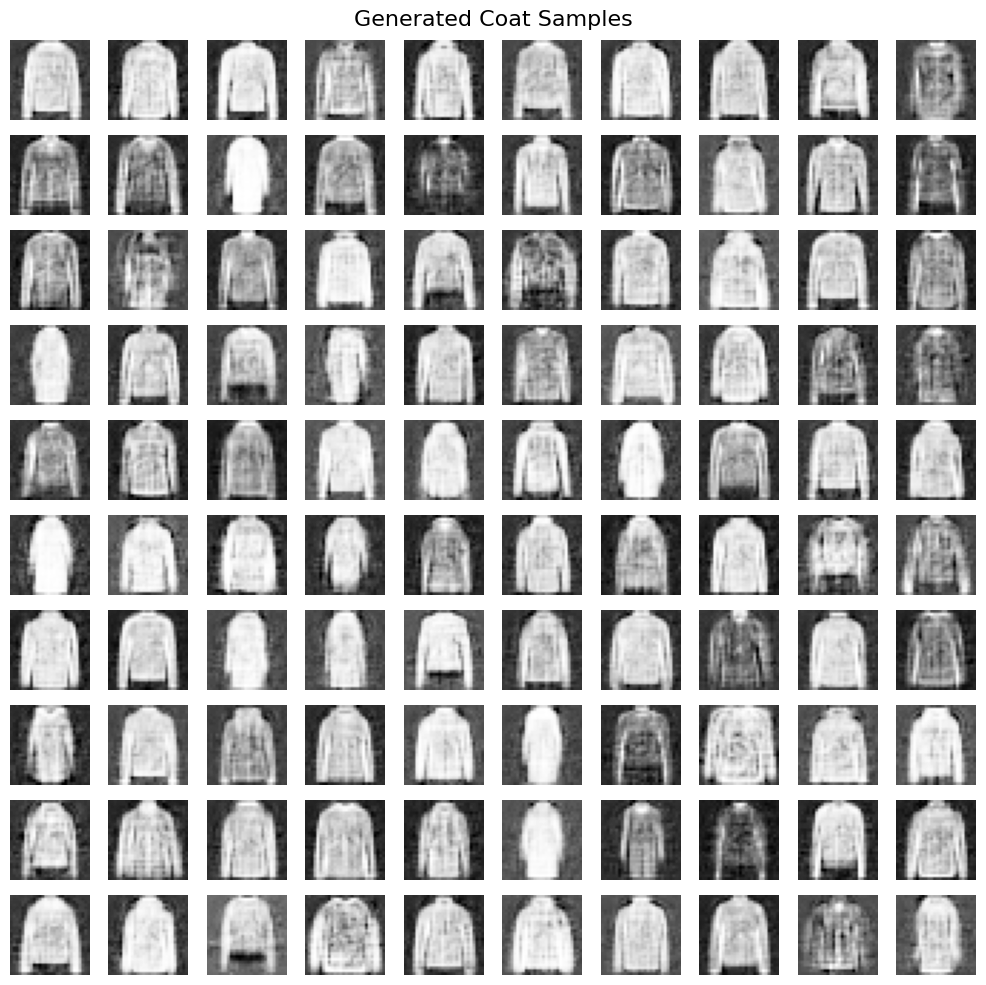

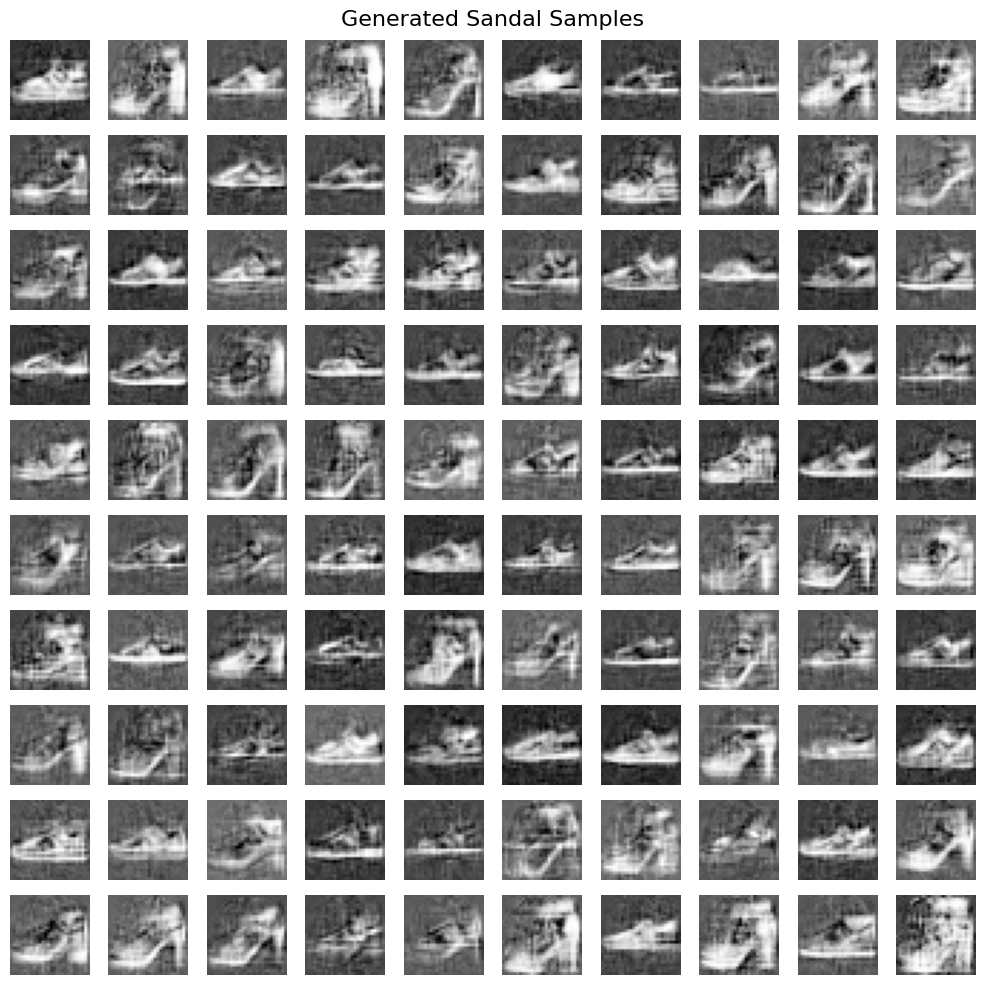

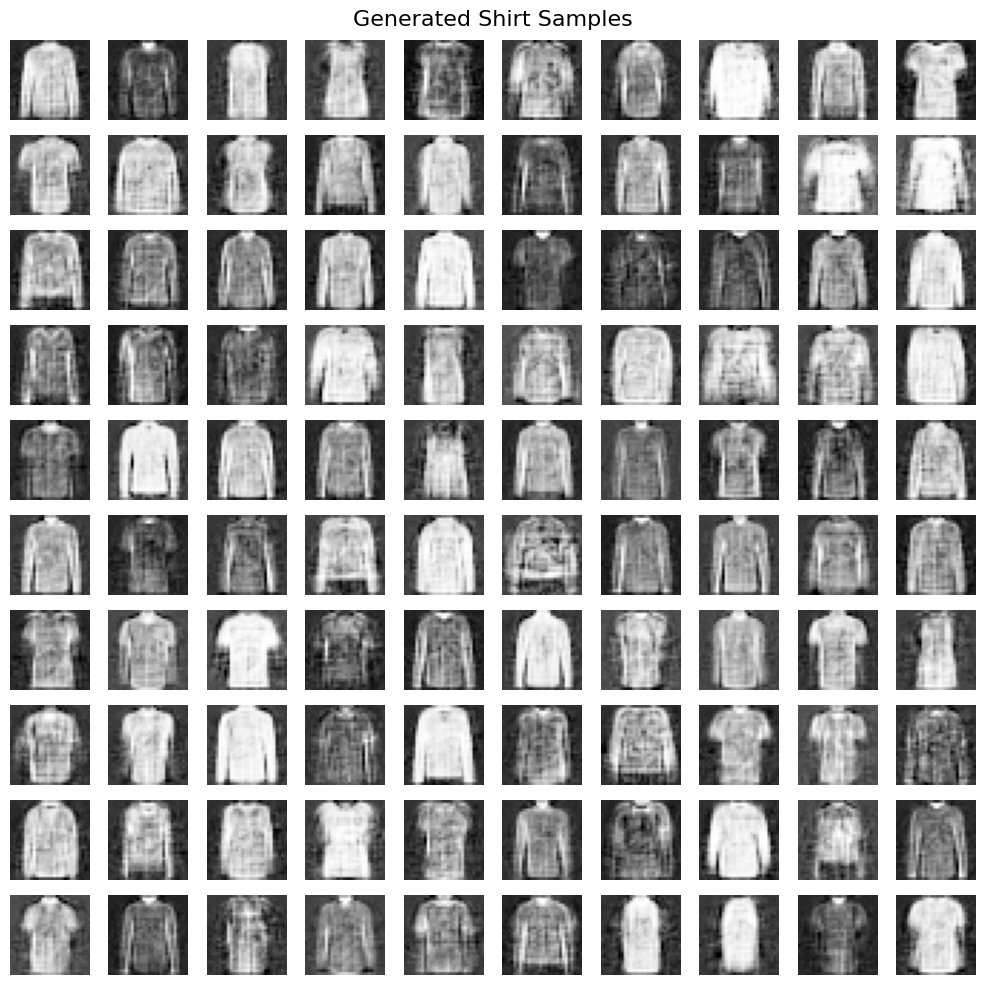

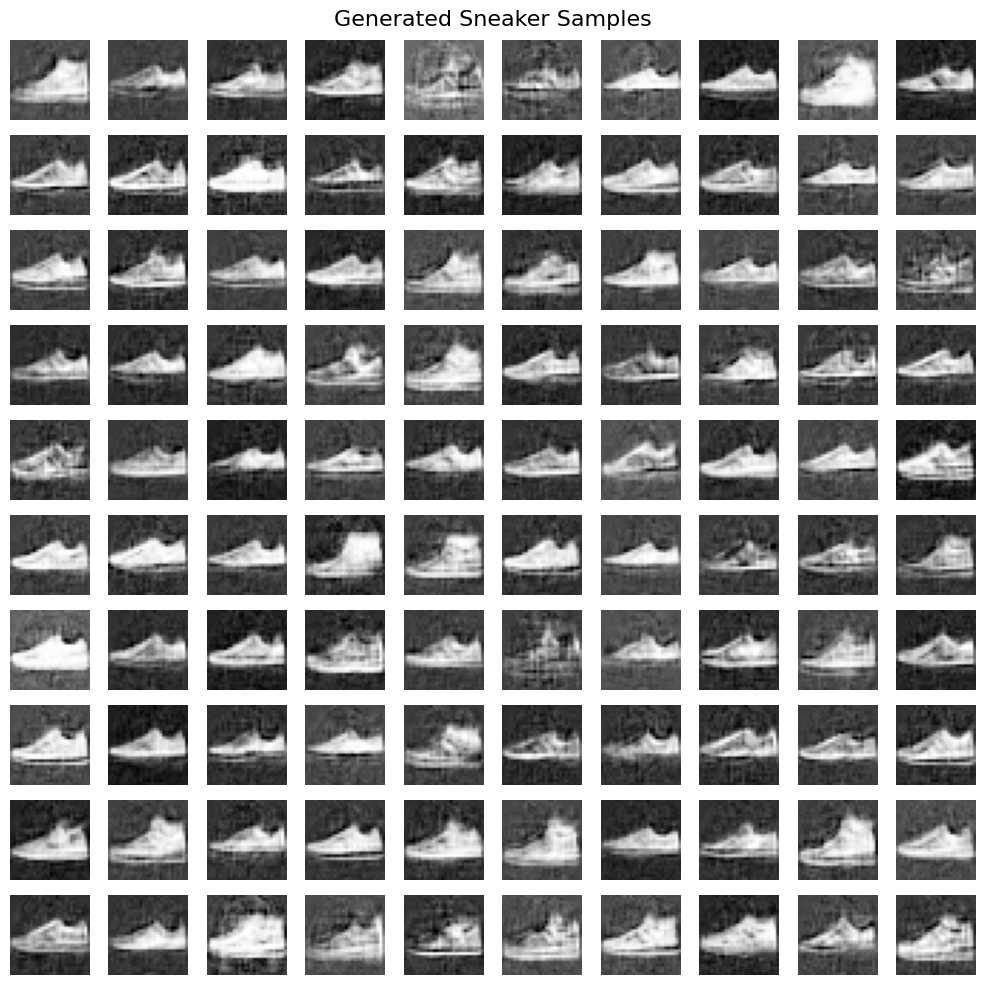

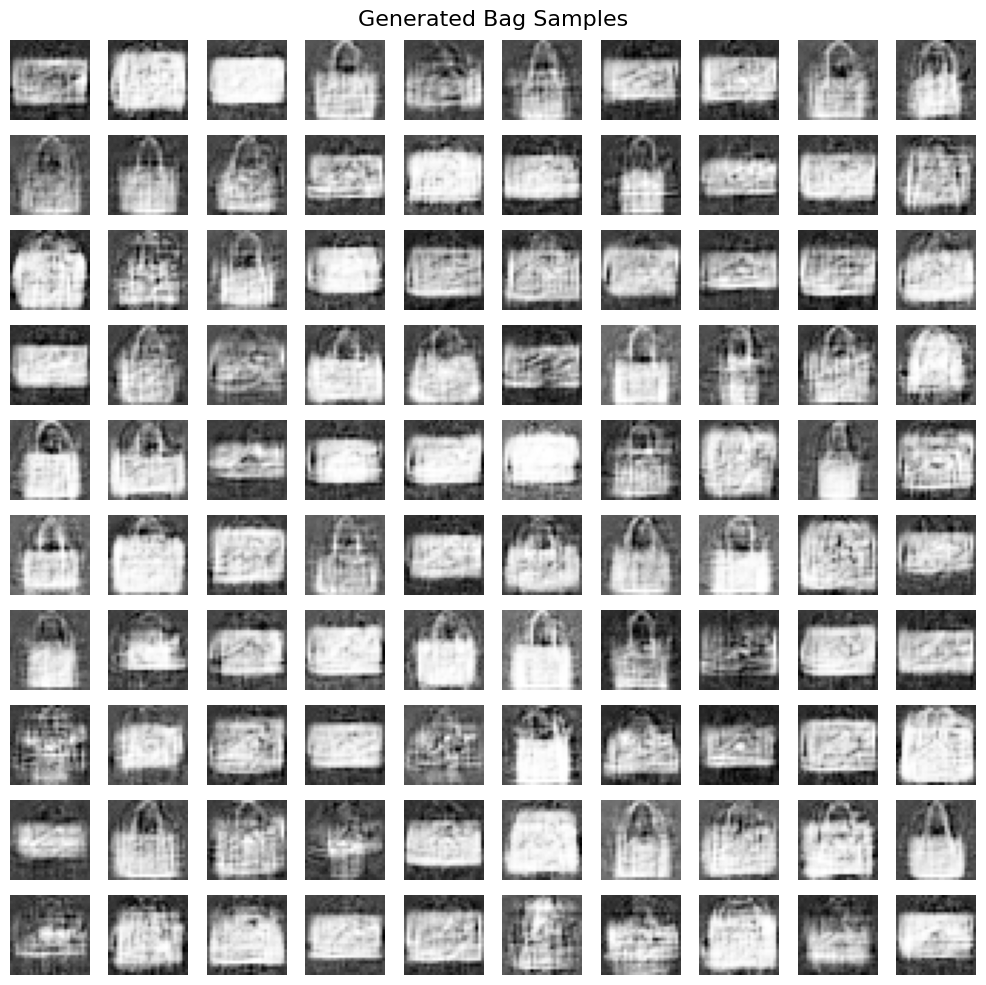

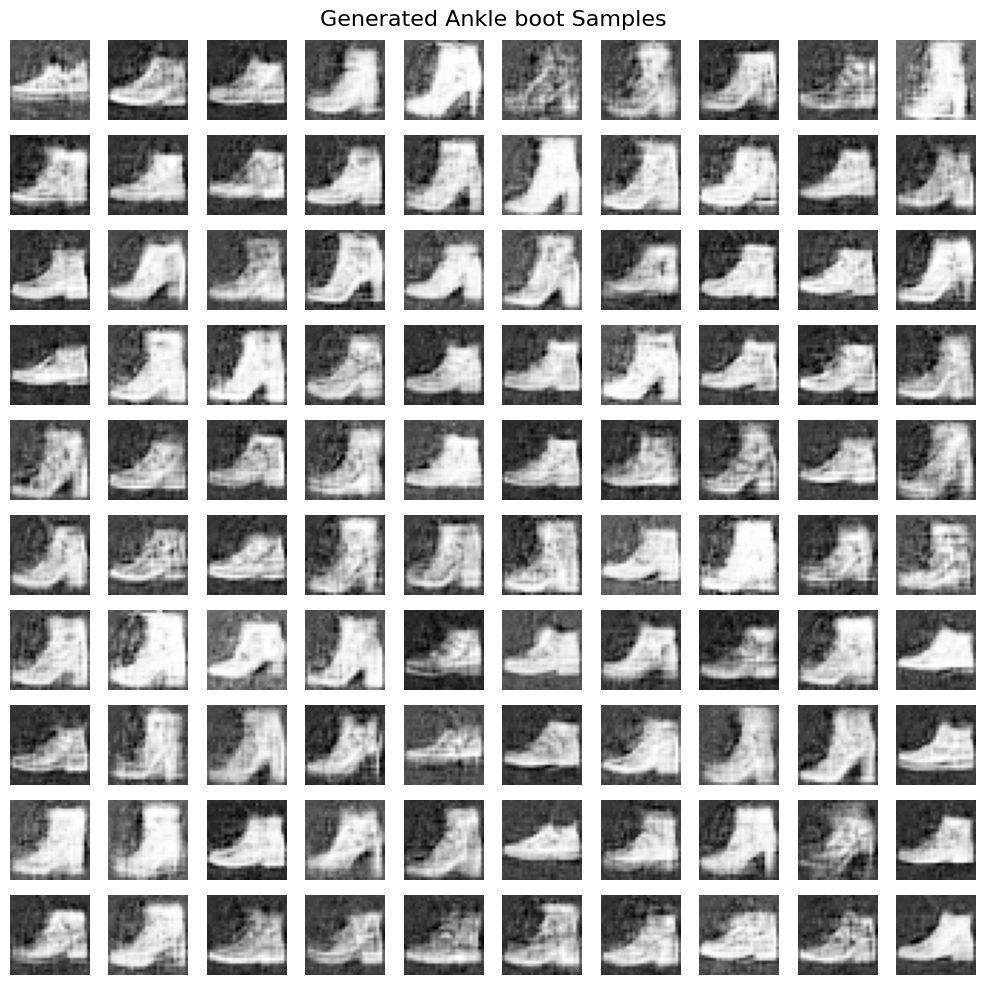

In [172]:
generate_class_samples(generator, class_label=0, n=100)
generate_class_samples(generator, class_label=1, n=100)
generate_class_samples(generator, class_label=2, n=100)
generate_class_samples(generator, class_label=3, n=100)
generate_class_samples(generator, class_label=4, n=100)
generate_class_samples(generator, class_label=5, n=100)
generate_class_samples(generator, class_label=6, n=100)
generate_class_samples(generator, class_label=7, n=100)
generate_class_samples(generator, class_label=8, n=100)
generate_class_samples(generator, class_label=9, n=100)

## Резльтат получился неплохим, учитывая простоту архитектуры нейронных сетей

## Что можно улучшить? Можно, например, использовать DCGAN (в предыдущих заданиях в том числе), заменив все полносвязные слои на сверточные.

## Задание 2: Diffusion Model (5 баллов)

1. Скачайте репозиторий:

    ```
    git clone https://github.com/awjuliani/pytorch-diffusion.git
    ```

2. Обучите модель для датасета Fasion MNIST. Продемонстрируйте обратный диффузионный процесс с нескольких random seeds (1 балл);

3. Добавьте к обучению DDPM условие на метку с помощью [Classifier Free Guidance](https://arxiv.org/abs/2207.12598) (2 балла);

4. Обучите модель в режиме inpainting \([параграф 4.1](https://arxiv.org/pdf/2201.09865.pdf)\) (2 балла);

5. Опишите проведенные эксперименты и полученные выводы.



---



# Домашнее задание № 8

Выполните все задания в этом ноутбуке.

Решение без отчета (текстового описания) будет оценено в 0 баллов.

+ Мягкий дедлайн: `02.04.25 23:59`
+ Жесткий дедлайн: `09.04.25 23:59` (половина баллов)


После жесткого дедлайна задание не принимается.